<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Send-Data-to-DB" data-toc-modified-id="Send-Data-to-DB-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Send Data to DB</a></span></li><li><span><a href="#Use-of-DB-views" data-toc-modified-id="Use-of-DB-views-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Use of DB views</a></span></li><li><span><a href="#Merged-data-extraction" data-toc-modified-id="Merged-data-extraction-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Merged data extraction</a></span></li><li><span><a href="#Normalize-and-deal-with-missing-values" data-toc-modified-id="Normalize-and-deal-with-missing-values-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Normalize and deal with missing values</a></span></li><li><span><a href="#Run-preliminary-models-w.-all-variables" data-toc-modified-id="Run-preliminary-models-w.-all-variables-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Run preliminary models w. all variables</a></span></li><li><span><a href="#Data-Exploration" data-toc-modified-id="Data-Exploration-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Data Exploration</a></span></li><li><span><a href="#Visualization-findings" data-toc-modified-id="Visualization-findings-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Visualization findings</a></span></li><li><span><a href="#Create-final-multivariate-model" data-toc-modified-id="Create-final-multivariate-model-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Create final multivariate model</a></span></li><li><span><a href="#Report-plots" data-toc-modified-id="Report-plots-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Report plots</a></span></li></ul></div>

Pipeline for data storage and merging. Intermediate results are displayed in this file but the worker functions are in Preprocess() in preprocessing.py.

In [7]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import settings
import sqlalchemy as sqla
from sqlalchemy.orm import sessionmaker
import time
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Lasso #L1 reg
from sklearn.svm  import SVR #Support vector regression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split

from scipy import stats

from sqlalchemy_declarative import *
from preprocessing import Preprocess


RANDOM_SEED = 2
PATH = "C:/Users/julia/Documents/coding/codingchallenges/qbiz/Archive/DataHealthProfiles/"
prep = Preprocess()

### Send Data to DB

In [3]:
#populate PostgreSQL database
prep.populate_db(PATH)

48 files gathered...

Sucessfully added acutesexuallytransmittedinfections
Sucessfully added adultssmoking
Sucessfully added alcoholspecifichospitalstaysunder18
Sucessfully added allageallcausemortalityaggregatetrend
Sucessfully added allethnicgroups
Sucessfully added asian
Sucessfully added averagedeprivedquintile
Sucessfully added black
Sucessfully added chinese
Sucessfully added deprivation
Sucessfully added drugmisuse
Sucessfully added earlydeathscanceraggregatetrend
Sucessfully added earlydeathscancer
Sucessfully added earlydeathsheartdiseaseandstroke
Sucessfully added earlydeathsheartdiseasestrokeaggregatetrend
Sucessfully added excesswinterdeaths
Sucessfully added gcseachieved5acincengmaths
Sucessfully added healthyeatingadults
Sucessfully added hipfracturein65sandover
Sucessfully added hospitalstaysforalcoholrelatedharm
Sucessfully added hospitalstaysforselfharm
Sucessfully added incidenceofmalignantmelanoma
Sucessfully added increasingandhigherriskdrinking
Sucessfully added in

### Use of DB views

I am planning to run multivariate models so it will be convenient to keep all indicator data in memory (rather than in the db). This is v. manageable as the data is small ~350x48. The time to extract all indicators from the db is relatively short (~700ms) but this will increase superlinearly with the number of samples. I experimented with views to speed this up but did not attain markedy better performance. See results below FYI. 

It would be overkill here, but with a (much) larger dataset I would use a preprocessing pipeline to create a clean dataset (stored in a db, on disk, or in cloud storage). I would then use PyTorch data loaders to make samples available for training. 

In [4]:
print("Std db access:")
%timeit prep.get_df_from_db_no_view() 
print()
#now create db view
t0 = time.time()
prep.create_db_view() #can only run this once
t1 = time.time()
print("Time taken for view creation:", t1-t0) 
print()

print("db access after creating view:")
%timeit prep.get_df_from_db_w_view()
print()

print("Time taken for std db access after creating view:") 
%timeit prep.get_df_from_db_no_view()  #i.e. using original query

Std db access:
783 ms ± 19.6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

View Created
Time taken for view creation: 0.533332109451294

db access after creating view:
668 ms ± 27.9 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

Time taken for std db access after creating view:
755 ms ± 17.9 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


The time for db access is reduced slightly by addition of views.

### Merged data extraction

In [3]:
df = prep.get_df_from_db_w_view()

#Split into independent and dependent variables
df_ABC, df_DE = prep.divide_into_ABC_DE(df)
(_, n_ind), (_, n_dep) = df_ABC.shape, df_DE.shape 
print("{} independent and {} dependent variables".format(n_ind, n_dep))

21 independent and 24 dependent variables


### Normalize and deal with missing values

In [6]:

scaler = StandardScaler() #Mean centres and normalizes per feature

scaler.fit(df_ABC)
X = scaler.transform(df_ABC) #converts into numpy array
X_names = dict(zip(range(len(df_ABC.columns)), df_ABC.columns))

scaler.fit(df_DE)
Y = scaler.transform(df_DE)
Y_names = dict(zip(range(len(df_DE.columns)), df_DE.columns))
X_names

{0: 'obesechildrenyear6',
 1: 'physicallyactiveadults',
 2: 'proportionofchildreninpoverty',
 3: 'smokinginpregnancy',
 4: 'adultssmoking',
 5: 'alcoholspecifichospitalstaysunder18',
 6: 'averagedeprivedquintile',
 7: 'deprivation',
 8: 'gcseachieved5acincengmaths',
 9: 'healthyeatingadults',
 10: 'increasingandhigherriskdrinking',
 11: 'leastdeprivedquintile',
 12: 'lessdeprivedquintile',
 13: 'longtermunemployment',
 14: 'moredeprivedquintile',
 15: 'mostdeprivedquintile',
 16: 'obeseadults',
 17: 'startingbreastfeeding',
 18: 'statutoryhomelessness',
 19: 'teenagepregnancyunder18',
 20: 'violentcrime'}

In [16]:
#First locate NaN values
print("X:", np.isnan(X).sum(axis=0))
print("Y:", np.isnan(Y).sum(axis=0))
X_col_bool = np.isnan(X).sum(axis=0) > 0 
Y_col_bool = np.isnan(Y).sum(axis=0) > 0 

X_col_idx = np.argwhere(X_col_bool == True).flatten()
Y_col_idx = np.argwhere(Y_col_bool == True).flatten()

nan_cols = []
for idx in X_col_idx:
    nan_cols.append(X_names[idx])
for idx in Y_col_idx:
    nan_cols.append(Y_names[idx])

print("Cols with NaN:", nan_cols)
print()


X: [0 0 0 7 0 0 0 0 0 0 0 0 0 0 0 0 0 5 0 0 0]
Y: [71  0  0  0  2  0  0  0  0  0  0  1  0  0  0  0  0]
Cols with NaN: ['smokinginpregnancy', 'startingbreastfeeding', 'other', 'acutesexuallytransmittedinfections', 'incidenceofmalignantmelanoma']



For the indicators listed above, I think that the majority were empty when there were insufficient instances of this event in the region in order to create the indicator (e.g if there were too few hospital visits from a given demographic to generate the proportion of hospital admissions indicator). These indicators are not counts so it is not valid to set them to zero. I will replace them with the average of a given column. 

In [17]:
col_mean_Y = np.nanmean(Y, axis=1).reshape((1, -1))
col_mean_X = np.nanmean(X, axis=1).reshape((1, -1))

#Find indicies that you need to replace
inds_X = np.where(np.isnan(X))
inds_Y = np.where(np.isnan(Y))

#Place column means in the indices. Align the arrays using take

Y[inds_Y] = np.take(col_mean_Y, inds_Y[0], axis = 1)
X[inds_X] = np.take(col_mean_X, inds_X[0], axis = 1)

#NOTE: this normalization and fill process is in 
#pred.normalize_and_fill_nan() for use later

### Run preliminary models w. all variables
I will run a few models to see general expresivity of data. Ideally I want to use a multivariate linear regression as a final model as the results are easier to interpret. 

In [4]:
def score_model(model, model_name, X, Y, cv):
    scores = cross_val_score(reg, X, Y, cv=cv)
    score = scores.mean()
    print("r^2 Score for {}: {:.4f}".format(model_name, score))
    print()
    return score

In [28]:
cv = 10 #for cross validation
reg = LinearRegression()
score_model(reg, "Linear Regression", X, Y, cv)


reg = RandomForestRegressor(n_estimators=100, criterion='mse', max_depth=None, min_samples_split=2, 
                      min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='auto', 
                      max_leaf_nodes=None, min_impurity_decrease=0.0, min_impurity_split=None, 
                      bootstrap=True, oob_score=False, n_jobs=None, random_state=RANDOM_SEED)
r = score_model(reg, "Random Forest", X, Y, cv)
#

r^2 Score for Linear Regression: 0.3672

r^2 Score for Random Forest: 0.3409



In [31]:
#Try with second order polynomial features
poly = PolynomialFeatures(degree=2)
Phi = poly.fit_transform(X)
reg = LinearRegression()
score_model(reg, "Linear Regression", Phi, Y, cv)


reg = RandomForestRegressor(n_estimators=100, criterion='mse', max_depth=None, min_samples_split=2, 
                      min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='auto', 
                      max_leaf_nodes=None, min_impurity_decrease=0.0, min_impurity_split=None, 
                      bootstrap=True, oob_score=False, n_jobs=None, random_state=RANDOM_SEED)
score = score_model(reg, "Random Forest", Phi, Y, cv)

r^2 Score for Linear Regression: -3.9842

r^2 Score for Random Forest: 0.3206



In [30]:
#As r^2 score is negative w. poly features, overfitting is occuring.
# Hence try regression with Regularization

reg = Lasso(alpha = 0.04, random_state=RANDOM_SEED)
score = score_model(reg, "Linear Regression w. Lasso", Phi, Y, cv)

r^2 Score for Linear Regression w. Lasso: 0.3671



This score is equally weighted according to predictive accuracy on all target variables (i.e. dependent variables) so 30% is not necessarily that bad. Now it is necessary to see which of the target variables are being predicted with high accuracy. I will use these findings to determine which variables are useful.

### Data Exploration
Create some prelimiary visualizations to investigate relationships in 2D. I want to ascertain which of the target variables are difficult to predict with the required data and then exclude them.

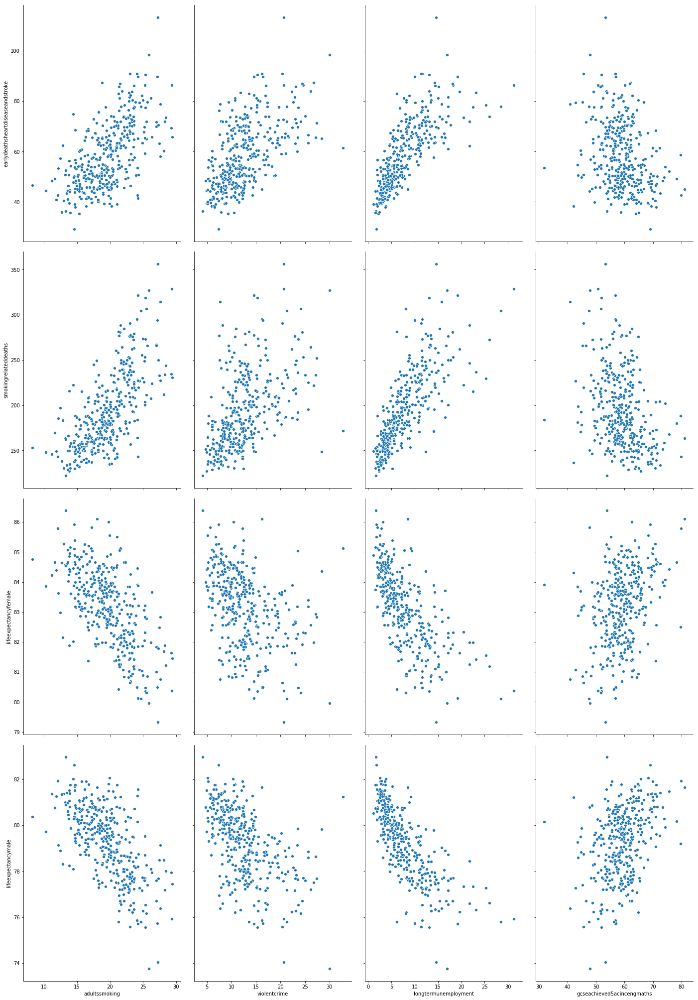

In [170]:
# visualize the relationship between the features and the response using pairplots such as this:
target = [ "earlydeathsheartdiseaseandstroke", "smokingrelateddeaths", "lifeexpectancyfemale", "lifeexpectancymale"]
x_vars = ["adultssmoking", "violentcrime", "longtermunemployment", "gcseachieved5acincengmaths"]
plot = sns.pairplot(df, x_vars=x_vars, y_vars=target, size=7, aspect=0.7)
fig = plot.fig.savefig("pairplot.png")


In [169]:
# Create a pairplot for all variables in the dataset - this will allow me to 
# quickly determine which relationships are interesting and deserve further investigation

# The result is too small to see in jupyter but I can download and zoom in
plot = sns.pairplot(df, size=7, aspect=0.7)
fig = plot.fig.savefig("pairplot_ALL.png")

In [171]:
#I did the same again but just with just independent variables on the x axis and dependent on the y
x_vars = list(X_names.values())
y_vars = list(Y_names.values()) 

plot = sns.pairplot(df, x_vars = x_vars, y_vars = y_vars, size=7, aspect=0.7)
fig = plot.fig.savefig("pairplot_Indep_Dep2.png")

### Visualization findings
There are a series of dependent variables that form almost perfect gaussians w.r.t every independent variable (i.e. they are random noise in the context of these inputs). These are listed in the next cell - a lot of them are hospital visits by demographic. I will exclude these variables. 

Studying the plots also revealed that there are a small number of very severe outliers. These would not be a problem in a classification task but will skew the predictions of a linear regression. Hence, I will remove them.  

In higher dimension problems, visualizations would not be feasible, but noisy target variables could be excluded on the basis of regression coefficients and confidence. 

### Create final multivariate model

In [52]:
# remove poor targets and predictors to get higher performance
# Also remove extreme outliers (with Z score > 4)
poor_target_variables = ["excesswinterdeaths","hipfracturein65sandover", 
                         "chinese", "asian", "black", "roadinjuriesanddeaths", "allethnicgroups", 
                         "unknown", "mixed", "other", "incidenceofmalignantmelanoma", "infantdeaths", "newcasesoftuberculosis"]
poor_predictive_variables = ["gcseachieved5acincengmaths", "obesechildrenyear6", "alcoholspecifichospitalstaysunder18", 
                             "smokinginpregnancy"]
cv = 10
#Run entire pipeline and model 
df = prep.get_df_from_db_w_view()
df_ = df.drop(columns=poor_target_variables)
df_ = df_.drop(columns=poor_predictive_variables)
df_no_o = prep.remove_outliers(df_) #remove just extreme outliers with Z score > 4
df_ABC, df_DE = prep.divide_into_ABC_DE(df_no_o)
X, X_names = prep.normalize_and_fill_nan(df_ABC)
Y, Y_names = prep.normalize_and_fill_nan(df_DE)

#Run models w. polynomial features and without for comparison
poly = PolynomialFeatures(degree=2)
Phi = poly.fit_transform(X)

reg = LinearRegression()
score_model(reg, "Linear Regression", X, Y, cv)
score_model(reg, "Linear Regression w. second order features", Phi, Y, cv)
reg = Lasso(alpha = 0.02, random_state=RANDOM_SEED)
score = score_model(reg, "Linear Regression w. Lasso", X, Y, cv)
score = score_model(reg, "Linear Regression w. Lasso w. second order features", X, Y, cv)

reg = RandomForestRegressor(n_estimators=100, criterion='mse', max_depth=None, min_samples_split=2, 
                      min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='auto', 
                      max_leaf_nodes=None, min_impurity_decrease=0.0, min_impurity_split=None, 
                      bootstrap=True, oob_score=False, n_jobs=None, random_state=RANDOM_SEED)
score = score_model(reg, "Random Forest", X, Y, cv)
score = score_model(reg, "Random Forest w. second order features", X, Y, cv)

361 datapoints reduced to 351
r^2 Score for Linear Regression: 0.4979

r^2 Score for Linear Regression w. second order features: -0.3175

r^2 Score for Linear Regression w. Lasso: 0.5050

r^2 Score for Linear Regression w. Lasso w. second order features: 0.5050

r^2 Score for Random Forest: 0.4819

r^2 Score for Random Forest w. second order features: 0.4819



The alterations have boosted performance considerably. Looking at the pairplot below it is clear that there is a useful dependency (i.e. non gaussian) between all pairs of dependent and independent variables. I will take the linear regression with regularization (i.e Lasso) as my final model. There appears to be no benefit in using second order features so I will only use the first order values. 

In [18]:
#Final model - I will train on the whole dataset. This will give a noisier value of R^2 
#but will likely give better predictions as it is trained on more samples
reg = Lasso(alpha = 0.02, random_state=RANDOM_SEED)
final_model = reg.fit(X, Y)
score = final_model.score(X, Y)
print("Final R^2 score (when trained on the whole dataset) is: {:.4f}".format(score))

Final R^2 score (when trained on the whole dataset) is: 0.7076


In [59]:
#most important params - extract the dimensions with the largest r^2_values

_, n_ind = X.shape
_, n_dep = Y.shape
r_square_list = [0 for x in range(n_ind)]
for idx_x in range(n_ind):
    for idx_y in range(n_dep):
        x_name = X_names[idx_x]
        y_name = Y_names[idx_y]
        slope, intercept, r_value, p_value, std_err = stats.linregress(X[:,idx_x],Y[:, idx_y])
        r_square = r_value **2
        r_square_list[idx_x] += 1.0 / n_dep * r_square
#find order of importance of independent variables
indices = sorted(range(len(r_square_list)),key=r_square_list.__getitem__)
print(indices)

[3, 14, 12, 13, 6, 16, 8, 10, 0, 2, 5, 7, 9, 1, 15, 4, 11]


In [64]:
best = X_names[8]
second = X_names[13]
third =  X_names[9]
fourth = X_names[15]
print(best, second, third, fourth)

lessdeprivedquintile startingbreastfeeding longtermunemployment teenagepregnancyunder18


c:\users\julia\documents\coding\codingchallenges\qbiz\venv\lib\site-packages\seaborn\axisgrid.py:2065: UserWarning: The `size` parameter has been renamed to `height`; pleaes update your code.
  warnings.warn(msg, UserWarning)


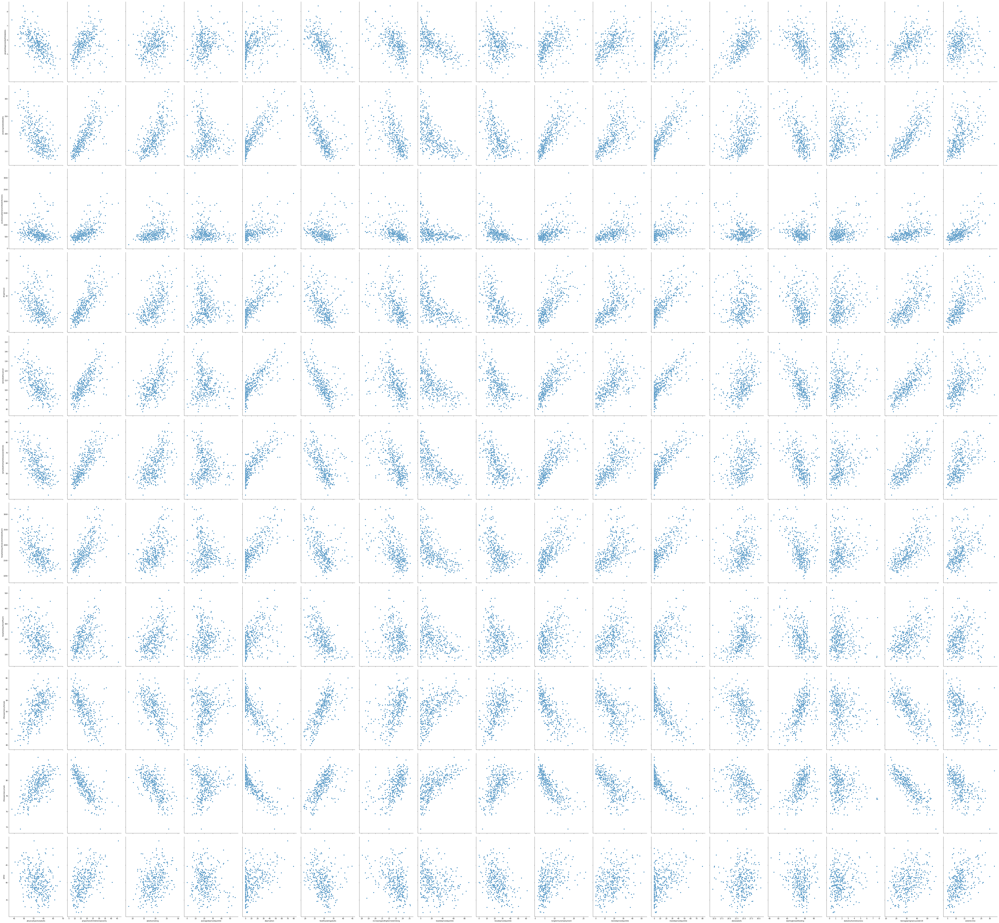

In [25]:
# Plot a final pairplot
# Note that all relationships are now non-gaussian.
x_vars = list(X_names.values())
y_vars = list(Y_names.values()) 
y_vars = [x for x in y_vars if x not in poor_target_variables]
x_vars = [x for x in x_vars if x not in poor_predictive_variables]

plot = sns.pairplot(df_no_o, x_vars = x_vars, y_vars = y_vars, size=7, aspect=0.7)
fig = plot.fig.savefig("pairplot_final.png")

### Report plots
For the report, it would not be instructive to include the above pairplot. Instead I will highlight particular 2D relationships that are particularly instructive. 

In [37]:
def plot_scatter(x, xlabel, y, ylabel, label_pos=None):
    """Plots a scatter graph with statistics and confidence intervals 
    and saves to file"""
   
    slope, intercept, r_value, p_value, std_err = stats.linregress(df[x],df[y])
    ax = sns.regplot(x, y, data=df, scatter=True, fit_reg=True, ci=95, n_boot=10000, units=None, order=1, 
                    robust=False, dropna=False, label=None, color=None, marker='+', scatter_kws=None, line_kws=None, ax=None)
    ax.set(xlabel=xlabel, ylabel=ylabel)
    if label_pos:
        r_value = r_value **2
        label = 'R^2 value: {:.4f}\np value: {:.4f}'.format(r_value, p_value)
        plt.annotate(label, xy=label_pos)
    plt.show()
    fp = "{}_{}".format(x,y)
    ax.get_figure().savefig("figures/{}".format(fp))

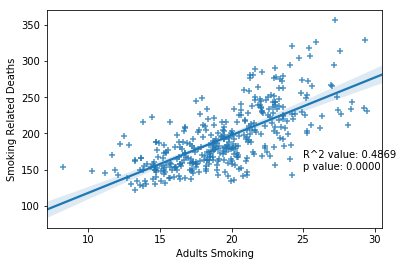

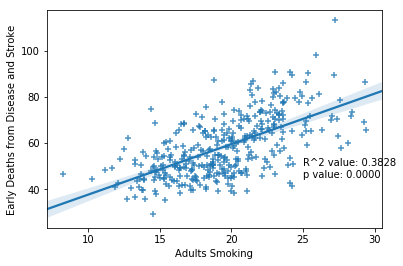

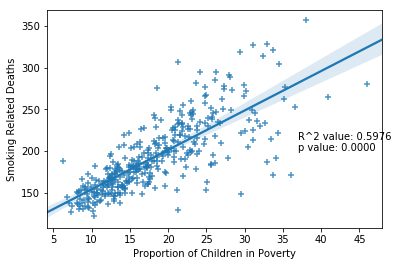

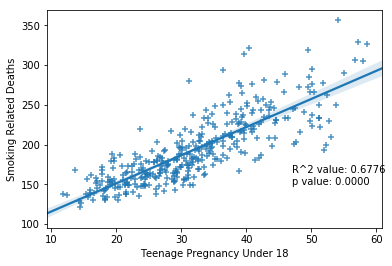

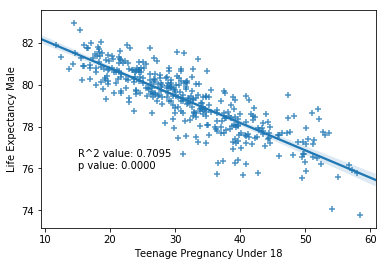

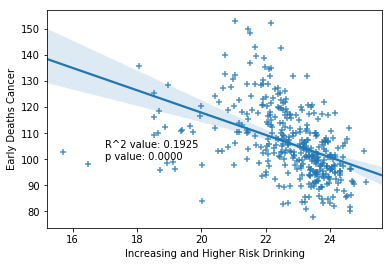

In [38]:
x = "adultssmoking"
y = "smokingrelateddeaths"
xlabel = 'Adults Smoking'
ylabel = 'Smoking Related Deaths'
plot_scatter(x, xlabel, y, ylabel, (25,150))

x = "adultssmoking"
y = "earlydeathsheartdiseaseandstroke"
xlabel='Adults Smoking'
ylabel='Early Deaths from Disease and Stroke'
plot_scatter(x, xlabel, y, ylabel, (25, 45))


x = "proportionofchildreninpoverty"
y = "smokingrelateddeaths"
xlabel='Proportion of Children in Poverty'
ylabel='Smoking Related Deaths'
plot_scatter(x, xlabel, y, ylabel, (37, 200))

x = "teenagepregnancyunder18"
y = "smokingrelateddeaths"
xlabel= "Teenage Pregnancy Under 18"
ylabel='Smoking Related Deaths'
plot_scatter(x, xlabel, y, ylabel, (47, 150))

x = "teenagepregnancyunder18"
y = "lifeexpectancymale"
xlabel= "Teenage Pregnancy Under 18"
ylabel='Life Expectancy Male'
plot_scatter(x, xlabel, y, ylabel, (15, 76))

x = "increasingandhigherriskdrinking"
y = "earlydeathscancer"
xlabel= "Increasing and Higher Risk Drinking"
ylabel='Early Deaths Cancer'
plot_scatter(x, xlabel, y, ylabel, (17, 100))